In [33]:
"""
Setup notebook
"""

# Python >= 3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn >= 0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 2.x
    !pip install -q -U tfx==0.21.2
    print("You can safely ignore the package incompatibility errors.")
except Exception:
    pass

# TensorFlow >= 2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

import numpy as np
import soundfile as sf
import os
import glob
import tqdm
import json
import librosa
from librosa import display
from pathlib import Path
import IPython.display as pd
import matplotlib.pyplot as plt

from madmom.io import midi
import warnings

print(midi)

<module 'madmom.io.midi' from '/opt/miniconda3/envs/dl4aed/lib/python3.7/site-packages/madmom/io/midi.py'>


## Plot 4 random Train .wav files

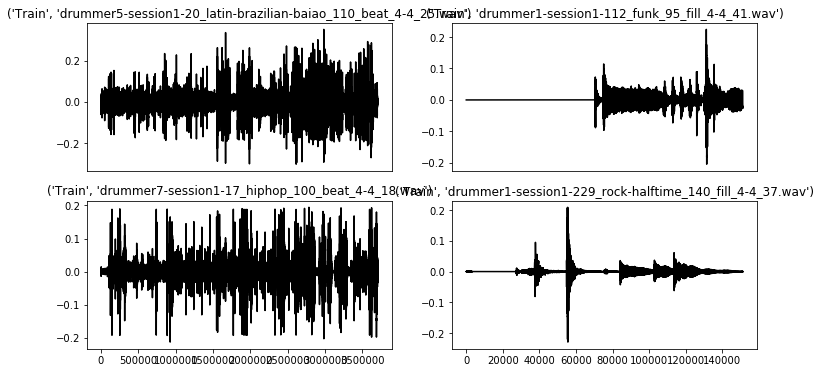

In [2]:
# get all wav files
fps = glob.glob('/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/*.wav', recursive=True)
fps_random = []
np.random.seed(9)

# setup subplot 
nrows, ncols = 2, 2
fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(12, 6))

# plot some audio waveforms
for r in range(nrows):
    for c in range(ncols):
        fp_random = fps[np.random.randint(len(fps))]
        audio, sr = librosa.core.load(fp_random, sr=None)
        ax[r][c].plot(audio, c='k')
        # ax[r][c].axis('off')
        ax[r][c].set_title(Path(fp_random).parts[-2:])
        if r == 0:
            ax[r][c].set_xticks([])
        # save random audio filepaths
        fps_random.append(fp_random)

# Play audio

In [3]:
# listen to the audio samples
for fp in fps_random:
    print(fp)
    pd.display(pd.Audio(fp))

/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/drummer5-session1-20_latin-brazilian-baiao_110_beat_4-4_25.wav


/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/drummer1-session1-112_funk_95_fill_4-4_41.wav


/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/drummer7-session1-17_hiphop_100_beat_4-4_18.wav


/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/drummer1-session1-229_rock-halftime_140_fill_4-4_37.wav


## Spectograms

## Config File

In [12]:
# 7 hits from the original paper
classes = ['KD','SD','TT','HH','CY','RD','BE']

# best-practice: write down your preprocessing config in a dictonary
config = {'sr': 44100, 
          'audio_length': 1,  # in seconds, should be fixed
          'mono': True,
          'n_mels': 250,  # number bins / vertical resolution? 250
          'n_fft': 2048,  # 2048 samples for fft
          'hop_length': 441, # shift to the right / frames with 10ms width
          'win_length': 2048,
          'window': 'hann',
          'center': True,
          'pad_mode': 'reflect',
          'power': 2.0,
          'classes': classes
         }

# save number of frames from length in samples divided by fft hop length
config['n_frames'] = int(config['sr']*config['audio_length']/config['hop_length']) + 1

# save input shape for model
config['input_shape'] = (config['n_mels'], config['n_frames'], 1)

# save config 
with open('/Volumes/Ext_SSD/e-gmd-v1.0.0/e-gmd.json', 'w+') as fp:
    json.dump(config, fp, sort_keys=True, indent=4)

# pretty print json
print(json.dumps(config, indent=4))

{
    "sr": 44100,
    "audio_length": 1,
    "mono": true,
    "n_mels": 250,
    "n_fft": 2048,
    "hop_length": 441,
    "win_length": 2048,
    "window": "hann",
    "center": true,
    "pad_mode": "reflect",
    "power": 2.0,
    "classes": [
        "KD",
        "SD",
        "TT",
        "HH",
        "CY",
        "RD",
        "BE"
    ],
    "n_frames": 101,
    "input_shape": [
        250,
        101,
        1
    ]
}


44100


/opt/miniconda3/envs/dl4aed/lib/python3.7/site-packages/librosa/filters.py:239: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  "Empty filters detected in mel frequency basis. "


44100
44100
44100
Melspec shape: (250, 343)
Stft shape: (1025, 343)
Total data points in mel-spectrogram: 85750
Total data points in stft-spectrogram: 351575
-> Data Reduction by factor: 4.1



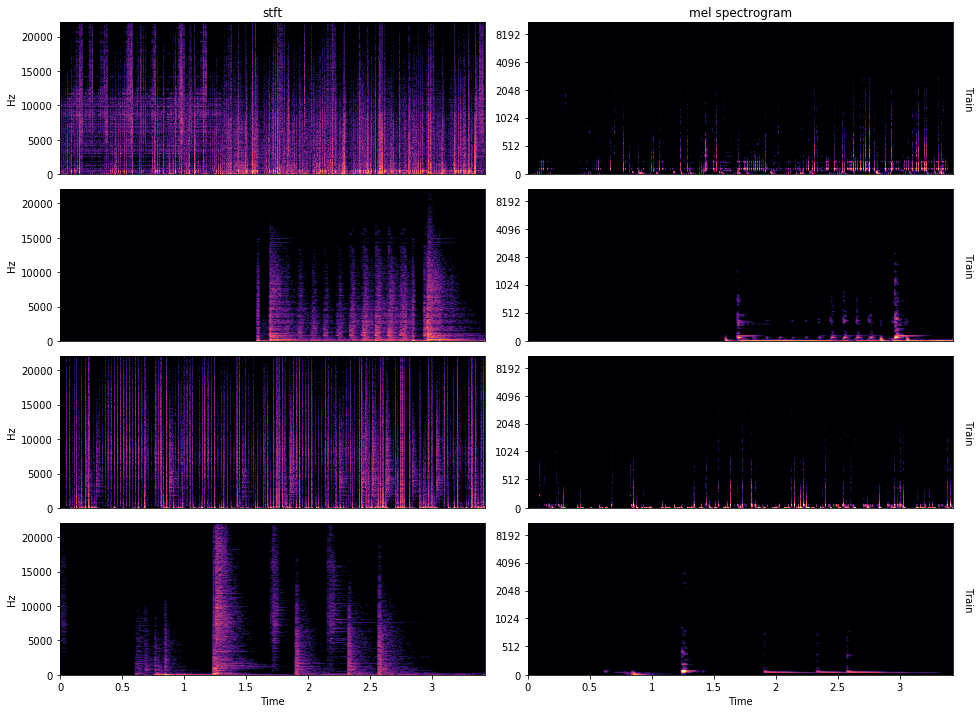

In [5]:
# setup subplot 
nrows, ncols = 4, 2
fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(16, 12))

# plot some audio waveforms
for i, fp_random in enumerate(fps_random):
    audio, sr = librosa.core.load(fp_random, sr=None)
    print(sr)
    # calculate stft
    stft = librosa.stft(audio, n_fft=config['n_fft'], hop_length=config['hop_length'], win_length=config['win_length'])
    
    # calculate melspec
    melspec = librosa.feature.melspectrogram(audio, n_fft=config['n_fft'], hop_length=config['hop_length'], win_length=config['win_length'], n_mels=config['n_mels'], fmax=int(config['sr']/2))
    melspec = librosa.amplitude_to_db(melspec, ref=np.max)

    # calculate magnitude and scale to dB
    magspec = librosa.amplitude_to_db(np.abs(stft), ref=np.max)

    # plot with librosa
    librosa.display.specshow(magspec, x_axis='time', y_axis='linear', sr=config['sr'], hop_length=config['hop_length'], ax=ax[i][0])
    librosa.display.specshow(melspec, x_axis='time', y_axis='mel', sr=config['sr'], hop_length=config['hop_length'], ax=ax[i][1])
    
    # adjustments
    # ax[i][1].set_yticks([])
    ax[i][1].set_ylabel(Path(fp_random).parts[-2], rotation=270, labelpad=20)
    ax[i][1].yaxis.set_label_position("right")
    
    # settings for all axises but bottom ones
    if not i == len(fps_random) - 1:
        ax[i][0].set_xticks([])
        ax[i][1].set_xticks([])
        ax[i][0].set_xlabel('')
        ax[i][1].set_xlabel('')
    
    # settings for upper axises
    if i == 0:
        ax[i][0].set_title('stft')
        ax[i][1].set_title('mel spectrogram')   

# adjust whitespace in between subplots        
plt.subplots_adjust(hspace=0.1, wspace=0.1)

print('Melspec shape: %s' % (str(melspec.shape)))
print('Stft shape: %s' % (str(stft.shape)))
print(f'Total data points in mel-spectrogram: {melspec.shape[0]*melspec.shape[1]}')
print(f'Total data points in stft-spectrogram: {stft.shape[0]*stft.shape[1]}')
print(f'-> Data Reduction by factor: {(stft.shape[0]*stft.shape[1]) / (melspec.shape[0]*melspec.shape[1])}')
print()

## Mel Filter

In [6]:
# generate mel-filter matrix
mel_filter = librosa.filters.mel(config['sr'], 
                                 config['n_fft'], 
                                 n_mels=config['n_mels'], 
                                 fmin=0.0, 
                                 fmax=None, 
                                 htk=False, 
                                 norm='slaney', 
                                 dtype=np.float32)

## Get Labels From Midi

In [24]:
# corresponding MIDI values   
# https://github.com/magenta/magenta/blob/master/magenta/models/onsets_frames_transcription/drum_mappings.py
GROOVE_PITCH_NAMES = {
    36: 'Kick', # 0
    38: 'Snare_Head', # 1
    40: 'Snare_Rim',
    37: 'Snare_X-Stick',
    48: 'Tom1',
    50: 'Tom1_Rim',
    45: 'Tom2',
    47: 'Tom2_Rim',
    43: 'Tom3_Head',
    58: 'Tom3_Rim',
    46: 'HHOpen_Bow',
    26: 'HHOpen_Edge',
    42: 'HHClosed_Bow',
    22: 'HHClosed_Edge',
    44: 'HHPedal',
    49: 'Crash1_Bow',
    55: 'Crash1_Edge',
    57: 'Crash2_Bow',
    52: 'Crash2_Edge',
    51: 'Ride_Bow',
    59: 'Ride_Edge',
    53: 'Ride_Bell',
    # New
    39: 'Clap',
    54: 'Tambourine',
    56: 'Cowbell',
    70: 'Maracas',
    64: 'Low_Conga',
    75: 'Claves',
}

# map 0- Anzahl Drumtypes, neues Dict key(midi): 0-30
#drum_mapping

In [37]:
def get_y_from_file(midifile, audio_options):
    with warnings.catch_warnings():
        warnings.simplefilter('ignore')
        print(type(midi))
        pattern = midi.MIDIFile(midifile)
        dt = float(audio_options['hop_length']) / float(audio_options['sr'])

        y_onsets = np.zeros((config['n_frames'], 88), dtype=np.uint8)  # why 88 and not 7 (num of classes)
        # y_frames = np.zeros((config['n_frames'], 88), dtype=np.uint8)
        # y_offsets = np.zeros((config['n_frames'], 88), dtype=np.uint8)

        for onset, _pitch, duration, velocity, _channel in pattern.notes:
            pitch = int(_pitch) 
            label = drum_mapping[pitch] # - 21

            note_start = int(np.round(onset / dt))
            note_end = int(np.round((onset + duration) / dt))

            # some of the midi-files have onsets/offsets larger
            # than n_frames. they were manually checked, and it's
            # actually not an issue at all.
            # see data-preparation/maestro-inconsistencies/* for
            # scripts that perform visual inspection!
            if note_start < config['n_frames']:
                if note_end >= config['n_frames']:
                    # print('weird_offset', midifile)
                    note_end = config['n_frames'] - 1

                y_onsets[note_start, label] = 1
                # y_frames[note_start:note_end + 1, label] = 1
                # y_offsets[note_end, label] = 1
            else:
                # print('weird_onset', midifile)
                pass

        return y_onsets #, y_frames, y_offsets

path_train_midi = glob.glob('/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/*.midi', recursive=True)[0]
print(path_train_midi)
y_onsets = get_y_from_file(path_train_midi, config)  # , y_frames, y_offsets
print(y_onsets.shape)


/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/drummer1-session1-101_dance-disco_120_beat_4-4_1.midi
<class 'module'>
(101, 88)


## Preprocessing Functions

In [13]:
def folder_name_to_one_hot(file_path):
    
    # for example: _data/TinyUrbanSound8k/train/siren/157648-8-0-0_00.wav
    label = Path(file_path).parts[-2]  # BD & SD, multi-label problem
    label_idx = classes.index(label)
    
    # get one hot encoded array
    one_hot = tf.one_hot(label_idx, len(config['classes']), on_value=None, off_value=None, 
                         axis=None, dtype=tf.uint8, name=None)
    return one_hot


def load_and_preprocess_data(file_path):
    # path string is saved as byte array in tf.data.dataset -> convert back to str
    if type(file_path) is not str:
        file_path = file_path.numpy()
        file_path = file_path.decode('utf-8')
    
    
    # load audio data 
    y, _ = librosa.core.load(file_path, sr=config['sr'], mono=config['mono'], offset=0.0, duration=None, 
                             dtype=np.float32, res_type='kaiser_best')

    # calculate stft from audio data
    stft = librosa.core.stft(y, n_fft=config['n_fft'], hop_length=config['hop_length'], 
                             win_length=config['win_length'], window=config['window'], 
                             center=config['center'], dtype=np.complex64, pad_mode=config['pad_mode'])

    # filter stft with mel-filter
    mel_spec = mel_filter.dot(np.abs(stft).astype(np.float32) ** config['power'])
    
    # add channel dimension for conv layer  compatibility
    mel_spec = np.expand_dims(mel_spec, axis=-1)
    
    # get ground truth from file_path string / from MIDI!!
    one_hot = folder_name_to_one_hot(file_path)
    
    return mel_spec, one_hot


# there is a TF bug where we get an error if the size of the tensor from a py.function is not set manualy
# when called from a map()-function.
def preprocessing_wrapper(file_path):
    mel_spec, one_hot = tf.py_function(load_and_preprocess_data, [file_path], [tf.float32, tf.uint8])  
    
    mel_spec.set_shape([config['n_mels'], config['n_frames'], 1])
    one_hot.set_shape([len(config['classes'])])
    return mel_spec, one_hot

## Offline Preprocessing

In [14]:
# autotune computation
AUTOTUNE = tf.data.experimental.AUTOTUNE

# folder with the training data
train_files = '/Volumes/Ext_SSD/e-gmd-v1.0.0/Train/*.wav'

# define a dataset of file paths
train_dataset = tf.data.Dataset.list_files(train_files)
# run the preprocessing via map
train_dataset = train_dataset.map(preprocessing_wrapper, num_parallel_calls=AUTOTUNE)
# save dataset to disk
!rm -rf /Volumes/Ext_SSD/e-gmd_Train
tf.data.experimental.save(dataset=train_dataset, path=f'/Volumes/Ext_SSD/e-gmd-v1.0.0/e-gmd_Train', compression='GZIP')
# show tensor types and shapes in dataset (we need this to load the dataset later)
print(train_dataset.element_spec)

# folder with the evaluation data
test_files = '/Volumes/Ext_SSD/e-gmd-v1.0.0/Test/*.wav'

# define a dataset of file paths
test_dataset = tf.data.Dataset.list_files(test_files)
# run the preprocessing via map
test_dataset = test_dataset.map(preprocessing_wrapper, num_parallel_calls=AUTOTUNE)
# save dataset to disk
!rm -rf /Volumes/Ext_SSD/e-gmd_Test
tf.data.experimental.save(dataset=test_dataset, path=f'/Volumes/Ext_SSD/e-gmd-v1.0.0/e-gmd_Test', compression='GZIP')

InvalidArgumentError: ValueError: 'Train' is not in list
Traceback (most recent call last):

  File "/opt/miniconda3/envs/dl4aed/lib/python3.7/site-packages/tensorflow/python/ops/script_ops.py", line 247, in __call__
    return func(device, token, args)

  File "/opt/miniconda3/envs/dl4aed/lib/python3.7/site-packages/tensorflow/python/ops/script_ops.py", line 135, in __call__
    ret = self._func(*args)

  File "/opt/miniconda3/envs/dl4aed/lib/python3.7/site-packages/tensorflow/python/autograph/impl/api.py", line 620, in wrapper
    return func(*args, **kwargs)

  File "<ipython-input-13-6844758ceb0b>", line 36, in load_and_preprocess_data
    one_hot = folder_name_to_one_hot(file_path)

  File "<ipython-input-13-6844758ceb0b>", line 5, in folder_name_to_one_hot
    label_idx = classes.index(label)

ValueError: 'Train' is not in list


	 [[{{node EagerPyFunc}}]] [Op:SaveDataset]

## Load Datasets

In [ ]:
# load a dataset from disk
train_dataset = tf.data.experimental.load(f'/Volumes/Ext_SSD/e-gmd-v1.0.0/e-gmd_Train', 
                                    (tf.TensorSpec(shape=(config['n_mels'], config['n_frames'], 1), dtype=tf.float32, name=None), 
                                     tf.TensorSpec(shape=(len(config['classes']),), dtype=tf.uint8, name=None)), 
                                    compression='GZIP')
# keep dataset in memory
train_dataset = train_dataset.cache()
# shuffle the data
train_dataset = train_dataset.shuffle(buffer_size=4000)  # adjust buffer_size
# batch examples
batch_size = 128
train_dataset = train_dataset.batch(batch_size)
# prefetch
train_dataset = train_dataset.prefetch(AUTOTUNE)

test_dataset = tf.data.experimental.load(f'/Volumes/Ext_SSD/e-gmd-v1.0.0/e-gmd_Test', 
                                    (tf.TensorSpec(shape=(config['n_mels'], config['n_frames'], 1), dtype=tf.float32, name=None), 
                                     tf.TensorSpec(shape=(len(config['classes']),), dtype=tf.uint8, name=None)), 
                                    compression='GZIP')
# keep dataset in memory
test_dataset = test_dataset.cache()
# batch examples
test_dataset = test_dataset.batch(batch_size)
# prefetch
test_dataset = test_dataset.prefetch(AUTOTUNE)

## Onset Model

In [ ]:
# create model architecture
model_onset = tf.keras.Sequential()
model_onset.add(tf.keras.Input(shape=config['input_shape']))
model_onset.add(tf.keras.layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu"))
model_onset.add(tf.keras.layers.BatchNormalization())
model_onset.add(tf.keras.layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu"))
model_onset.add(tf.keras.layers.BatchNormalization())
model_onset.add(tf.keras.layers.MaxPool2D(pool_size=(1, 2), strides=(1, 2)))
model_onset.add(tf.keras.layers.GaussianDropout(0.75))
model_onset.add(tf.keras.layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu"))
model_onset.add(tf.keras.layers.BatchNormalization())
model_onset.add(tf.keras.layers.MaxPool2D(pool_size=(1, 2), strides=(1, 2)))
model_onset.add(tf.keras.layers.GaussianDropout(0.75))
model_onset.add(tf.keras.layers.Dense(256, activation="relu"))
model_onset.add(tf.keras.layers.GaussianDropout(0.5))
model_onset.add(Bidirectional(LSTM(64),dropout=0.5))
model_onset.add(tf.keras.layers.Dense(88, activation="sigmoid"))
model_onset.summary()

## Compile and Fit

In [ ]:
# compile model
model_onset.compile(optimizer='adam',
              loss='sigmoid_cross_entropy',
              metrics=['accuracy'])

# Number of epochs to train (change it accordingly)
n_epochs = 10  # same as on fit()?

# train model
hist = model_onset.fit(X_train, y_train, batch_size=batch_size, epochs=n_epochs, verbose=1, validation_split=0.2)

# fit model
model_onset.fit(train_dataset, epochs=10)

# test
model_onset.evaluate(test_dataset)

## Velocity Model

In [ ]:
# create model architecture
model_veloc = tf.keras.Sequential() # initialize model
model_veloc.add(tf.keras.Input(shape=config['input_shape']))
model_veloc.add(tf.keras.layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu"))
model_veloc.add(tf.keras.layers.BatchNormalization())
model_veloc.add(tf.keras.layers.Conv2D(16, (3, 3), strides=(1, 1), activation="relu"))
model_veloc.add(tf.keras.layers.BatchNormalization())
model_veloc.add(tf.keras.layers.MaxPool2D(pool_size=(1, 2), strides=(1, 2)))
model_veloc.add(tf.keras.layers.GaussianDropout(0.75))
model_veloc.add(tf.keras.layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu"))
model_veloc.add(tf.keras.layers.BatchNormalization())
model_veloc.add(tf.keras.layers.MaxPool2D(pool_size=(1, 2), strides=(1, 2)))
model_veloc.add(tf.keras.layers.GaussianDropout(0.75))
model_veloc.add(tf.keras.layers.Dense(256, activation="relu"))
model_veloc.add(tf.keras.layers.GaussianDropout(0.5))
model_veloc.add(tf.keras.layers.Dense(88, activation="sigmoid")) 
model_veloc.summary()

## Compile and Fit

In [ ]:
# compile model
model_veloc.compile(optimizer='adam',
              loss='MSE',
              metrics=['accuracy'])

# fit model
model_veloc.fit(train_dataset, epochs=10)
model_veloc.evaluate(test_dataset)